# Example demonstrating usage of easygan on images of art
The data is located in the folder ```example_dataset``` and are low-resolution versions of this data: https://www.kaggle.com/ikarus777/best-artworks-of-all-time

## Read data into a list of images

In [1]:
%load_ext autoreload
%autoreload 2
import glob
import os
import matplotlib.pyplot as plt
import numpy as np

# Get images in example_dataset
paths = glob.glob(os.path.join(os.getcwd(), 'example_dataset/**/*.jpg'), recursive=True)    # get paths to all images
imgs = [plt.imread(path) for path in paths]    # list of images
n = len(imgs)
print ("Loaded %d images" % n)

Loaded 8774 images


## Show some example images

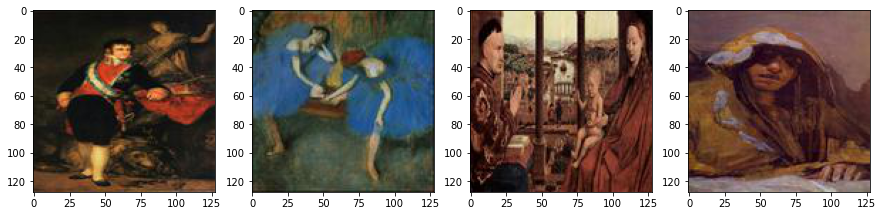

In [2]:
np.random.seed(5)
example_inds = np.random.randint(0, n, 4)
fig, ax = plt.subplots(1, 4, figsize=(15,30))

for idx, i in enumerate(example_inds):
    ax[idx].imshow(imgs[i])
    
plt.show()

## Normalize pixel values and create tensor of image data

In [3]:
import easygan as eg
imgs_tn = eg.preprocess(imgs)

## Train a GAN on the image data

In [4]:
artgan = eg.GAN()        # create instance of GAN class first

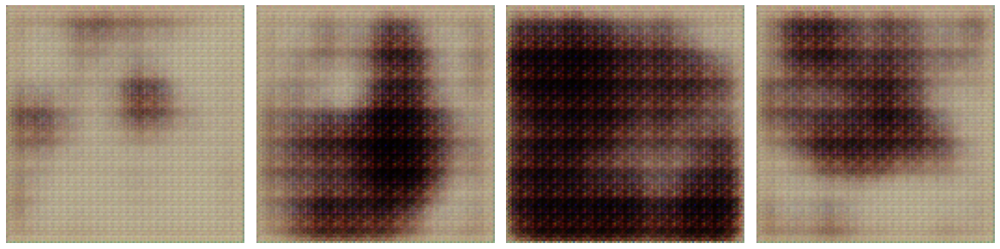

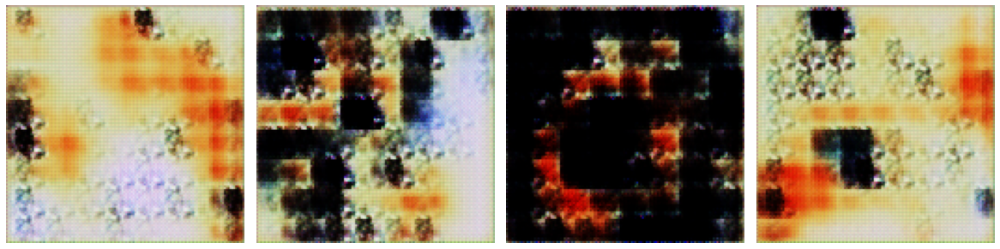

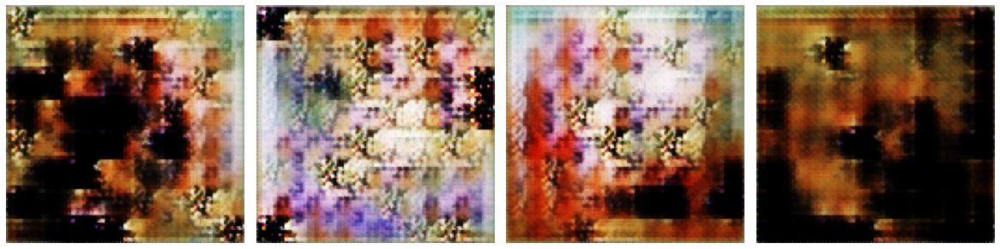

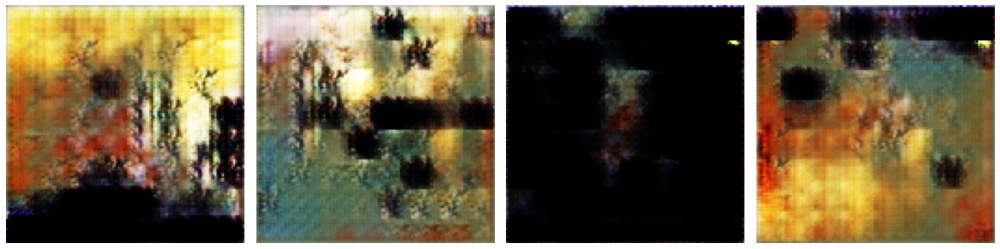

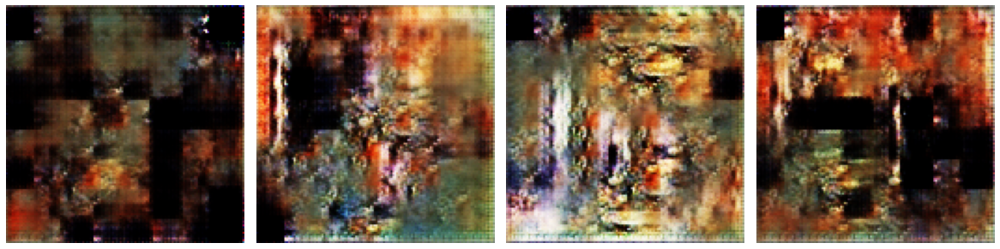

...

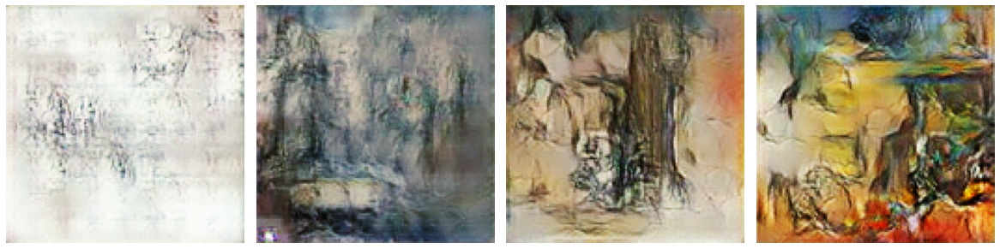

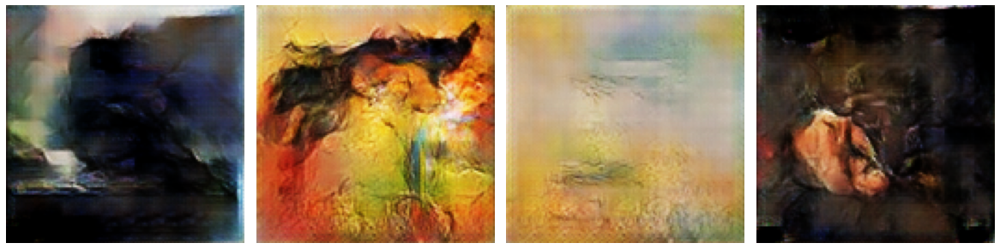

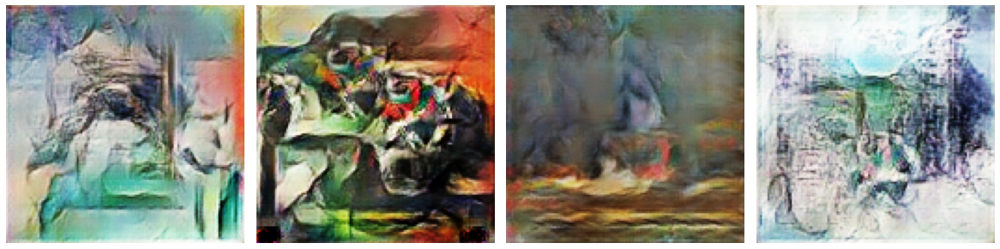

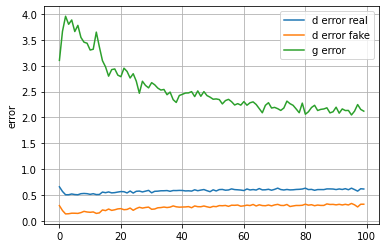

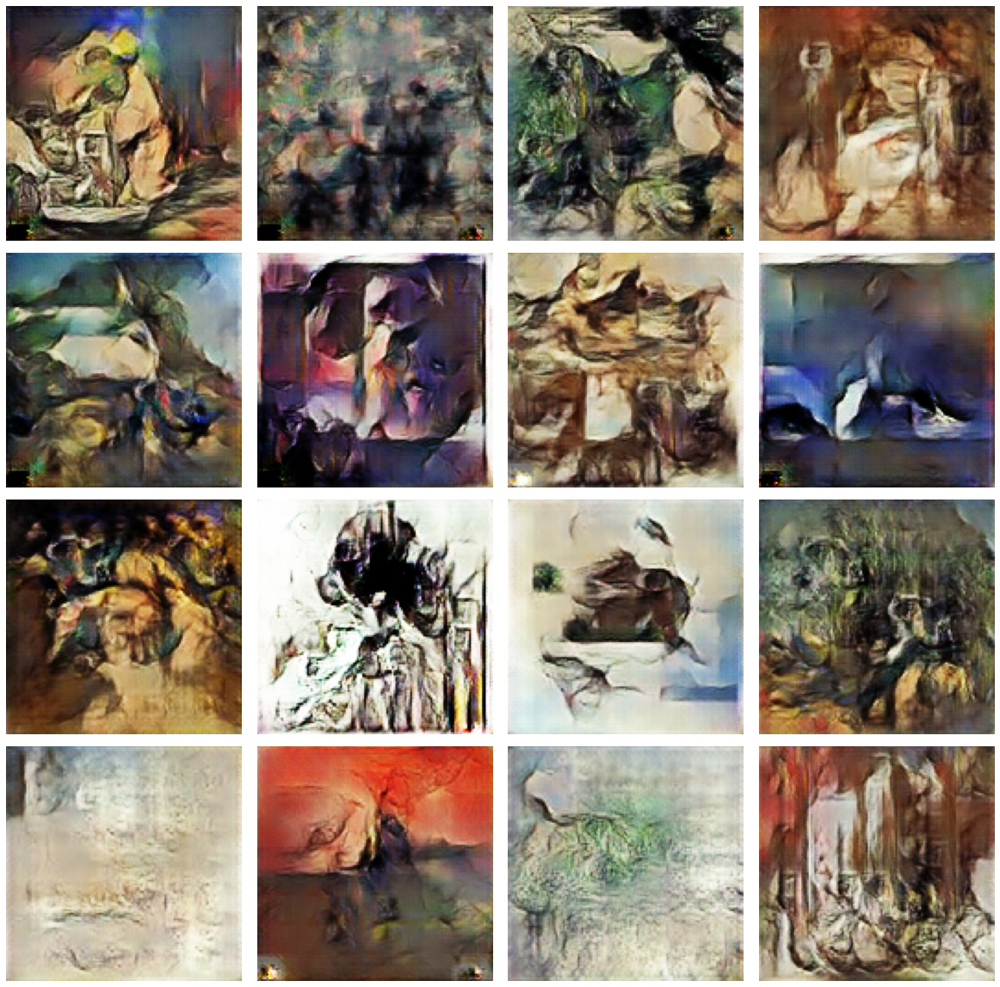

Saved generator as generator_100epochs_2021-08-28-1345
Saved discriminator as discriminator_100epochs_2021-08-28-1345


In [5]:
# train with input images imgs_tn with some user-defined properties
artgan.train_gan(imgs_tn, epochs=100, lr_g=0.0002, lr_d=0.0002, batch_size=16, DiffAugment=True, plot_interval=5)

## Use the trained generator to create some "art"

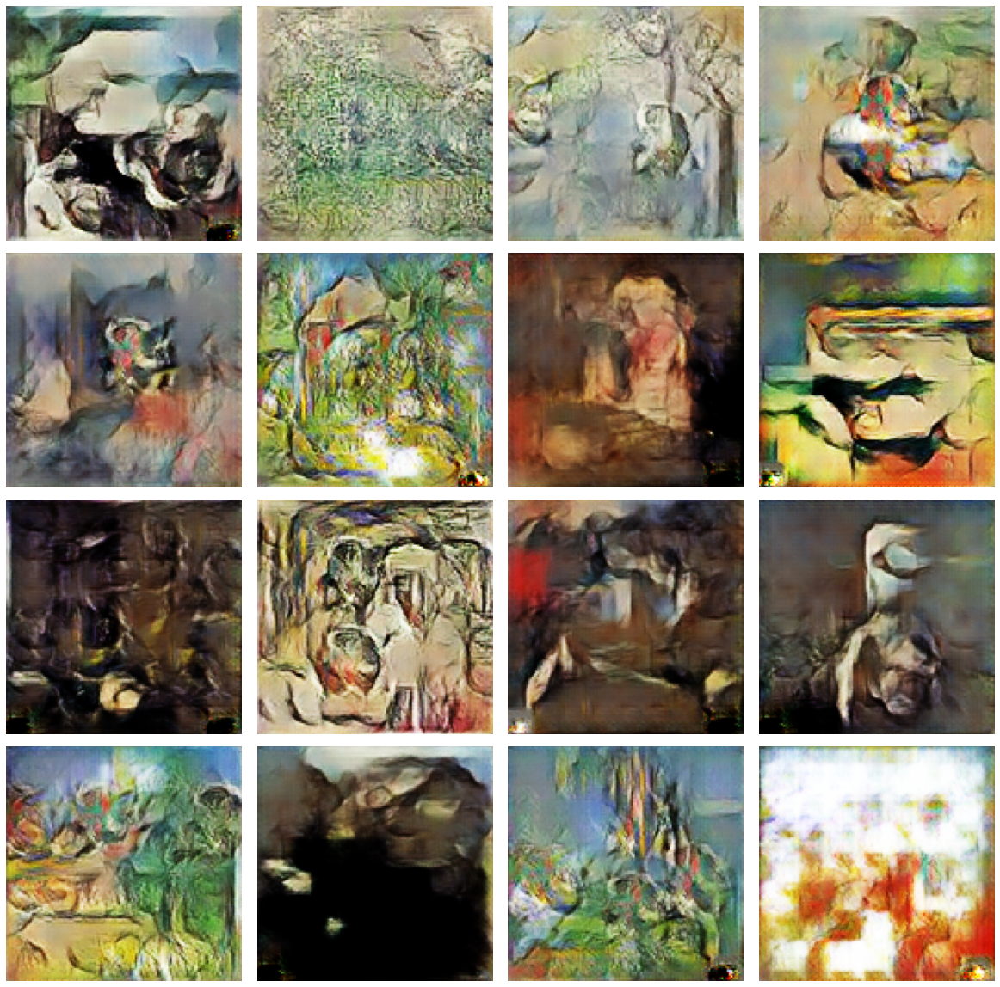

In [7]:
import torch
torch.manual_seed(42)          # adjust to get different results

fig, ax = plt.subplots(4, 4, figsize=(16,18), sharex=True, sharey=True)
plt.subplots_adjust(left=0, right=1, top=1, wspace=0.05, hspace=0.05)
for k in range(16):
    i = k // 4
    j = k % 4
    z = torch.randn(1, 100)
    img = artgan.generate_image(z)
    
    ax[i, j].imshow(img)
    ax[i, j].set_axis_off()
    
plt.show()

## Resume a saved state and continue training

In [5]:
artgan.load_state('2021-08-28-1345')       

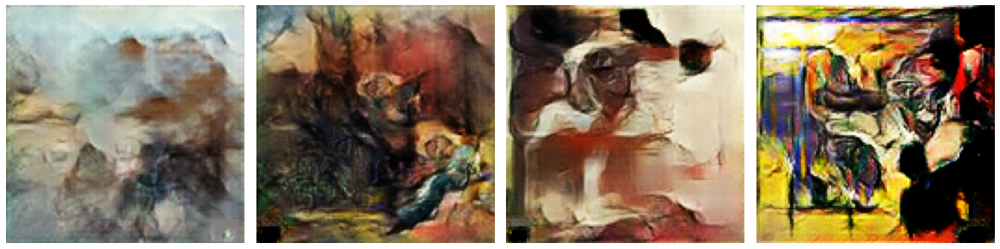

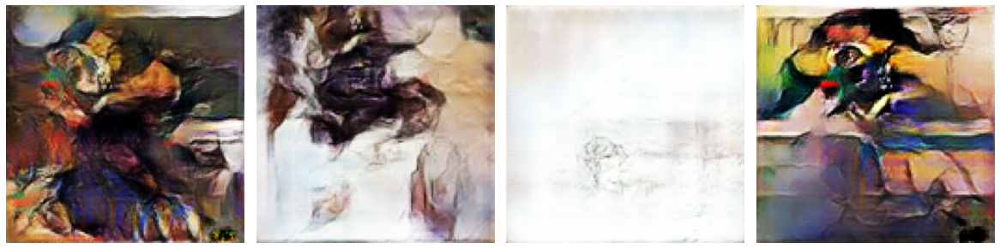

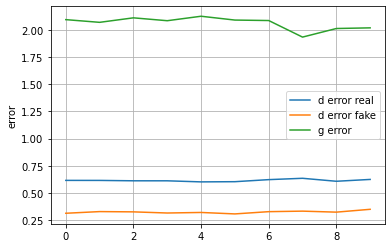

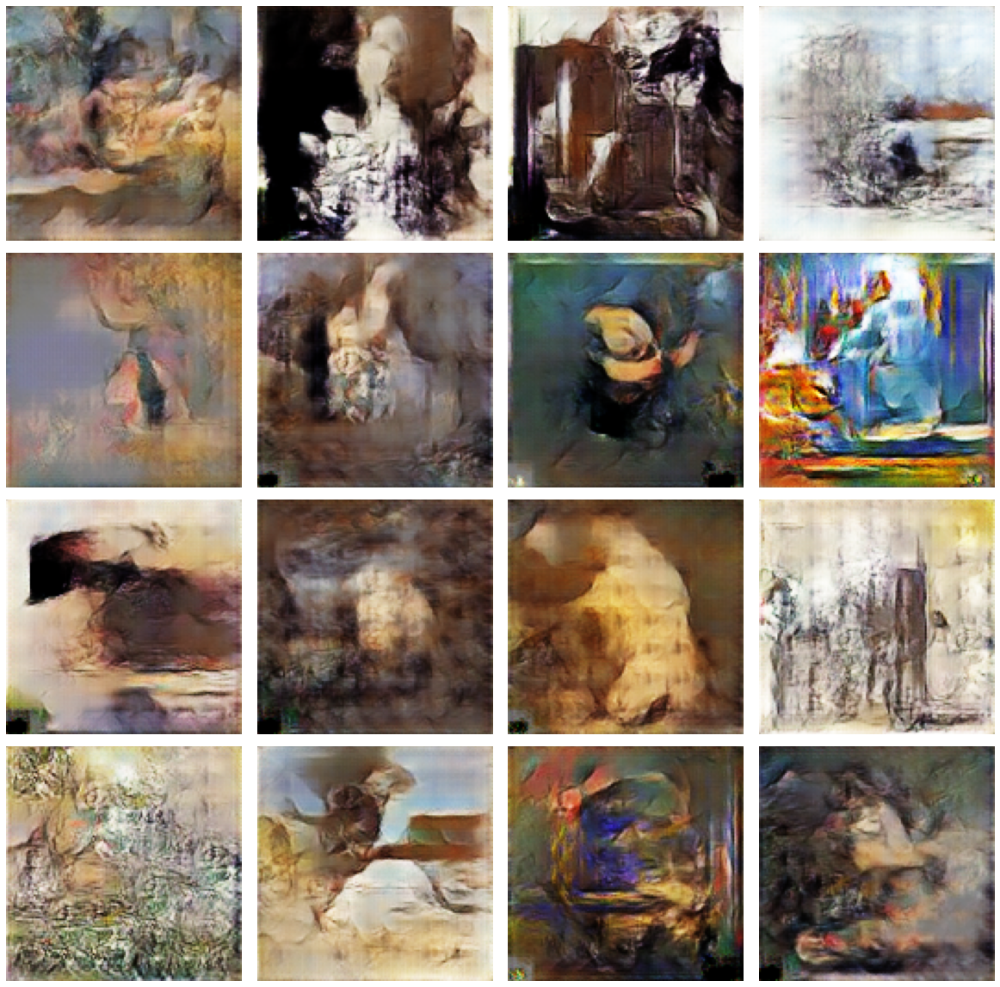

Saved generator as generator_10epochs_2021-08-28-1359
Saved discriminator as discriminator_10epochs_2021-08-28-1359


In [6]:
artgan.train_gan(imgs_tn, epochs=10, lr_g=0.0002, lr_d=0.0002, batch_size=16, DiffAugment=True, plot_interval=5)